In [1]:
import pycisTopic
import glob
import os
import pybiomart as pbm
import pandas as pd
import pickle
from pycisTopic.qc import *
from IPython.display import Image, display
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

import multiprocess as mp  # for kde multithreading calculation
from multiprocess import Pool

%matplotlib inline
%load_ext lab_black

# Download annotation

In [2]:
!pwd

/lustre1/project/stg_00090/scatac_benchmark/full_2_cistopic


In [3]:
wdir = "/lustre1/project/stg_00090/scatac_benchmark/full_2_cistopic"
os.chdir(wdir)

In [4]:
genome = "hg38"

pbm_genome_name_dict = {
    "hg38": "hsapiens_gene_ensembl",
    "hg37": "hsapiens_gene_ensembl",
    "mm10": "mmusculus_gene_ensembl",
    "dm6": "dmelanogaster_gene_ensembl",
}

pbm_host_dict = {
    "hg38": "http://www.ensembl.org",
    "hg37": "http://grch37.ensembl.org/",
    "mm10": "http://nov2020.archive.ensembl.org/",
    "dm6": "http://www.ensembl.org",
}

if os.path.exists(f"annotation.tsv"):
    print(f"Loading cached genome annotation...")
    annotation = pd.read_csv("annotation.tsv", sep="\t", header=0, index_col=0)
else:
    dataset = pbm.Dataset(name=pbm_genome_name_dict[genome], host=pbm_host_dict[genome])

    annot = dataset.query(
        attributes=[
            "chromosome_name",
            "transcription_start_site",
            "strand",
            "external_gene_name",
            "transcript_biotype",
        ]
    )
    filter = annot["Chromosome/scaffold name"].str.contains("CHR|GL|JH|MT")
    annot = annot[~filter]
    annot["Chromosome/scaffold name"] = annot["Chromosome/scaffold name"].str.replace(
        r"(\b\S)", r"chr\1"
    )
    annot.columns = ["Chromosome", "Start", "Strand", "Gene", "Transcript_type"]
    annot = annot[annot.Transcript_type == "protein_coding"]
    annot.to_csv("annotation.tsv", sep="\t")

Loading cached genome annotation...


In [5]:
import glob

In [6]:
sorted(glob.glob("../1_data_repository/full_fragments/*.tsv.gz"))

['../1_data_repository/full_fragments/BIO_ddseq_1.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/BIO_ddseq_2.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/BIO_ddseq_3.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/BIO_ddseq_4.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/BRO_mtscatac_1.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/BRO_mtscatac_2.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/CNA_10xmultiome_1.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/CNA_10xmultiome_2.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/CNA_10xv11_1.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/CNA_10xv11_2.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/CNA_10xv11_3.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/CNA_10xv11_4.FULL.fragments.tsv.gz',
 '../1_data_repository/full_fragments/CNA_10xv11_5.FULL.fragments.tsv.gz',
 '../1_data_rep

In [7]:
fragments_list = sorted(glob.glob("../1_data_repository/full_fragments/*.tsv.gz"))
fragments_dict = {}
for fragments_file in fragments_list:
    sample = fragments_file.split("/")[-1].split(".fragments.tsv.gz")[0]
    fragments_dict[sample] = fragments_file

In [8]:
fragments_dict

{'BIO_ddseq_1.FULL': '../1_data_repository/full_fragments/BIO_ddseq_1.FULL.fragments.tsv.gz',
 'BIO_ddseq_2.FULL': '../1_data_repository/full_fragments/BIO_ddseq_2.FULL.fragments.tsv.gz',
 'BIO_ddseq_3.FULL': '../1_data_repository/full_fragments/BIO_ddseq_3.FULL.fragments.tsv.gz',
 'BIO_ddseq_4.FULL': '../1_data_repository/full_fragments/BIO_ddseq_4.FULL.fragments.tsv.gz',
 'BRO_mtscatac_1.FULL': '../1_data_repository/full_fragments/BRO_mtscatac_1.FULL.fragments.tsv.gz',
 'BRO_mtscatac_2.FULL': '../1_data_repository/full_fragments/BRO_mtscatac_2.FULL.fragments.tsv.gz',
 'CNA_10xmultiome_1.FULL': '../1_data_repository/full_fragments/CNA_10xmultiome_1.FULL.fragments.tsv.gz',
 'CNA_10xmultiome_2.FULL': '../1_data_repository/full_fragments/CNA_10xmultiome_2.FULL.fragments.tsv.gz',
 'CNA_10xv11_1.FULL': '../1_data_repository/full_fragments/CNA_10xv11_1.FULL.fragments.tsv.gz',
 'CNA_10xv11_2.FULL': '../1_data_repository/full_fragments/CNA_10xv11_2.FULL.fragments.tsv.gz',
 'CNA_10xv11_3.FULL'

The regions we will count in. Here, I count everything in the human ENCODE SCREEN regions. You can also add a sample-specific region set, e.g. sample-specific peaks called on the sample's bams.

In [9]:
region = "../0_resources/regions/V2.hg38-rDHS-Unfiltered.blacklisted.bed"

Now, make a sub dictionary of all samples within the fragments dict that have not been run yet (good for resuming a stopped cistopic run):

In [10]:
cistopic_qc_out = os.path.join(wdir, "cistopic_qc_out")
if not os.path.exists(cistopic_qc_out):
    os.makedirs(cistopic_qc_out)

In [11]:
fragments_sub_dict = {}
regions_sub_dict = {}
for sample in fragments_dict:
    metadata_file = os.path.join(cistopic_qc_out, sample + "__metadata_bc.pkl")
    print(f"Checking if {metadata_file} exist...")
    if os.path.exists(metadata_file):
        print("\tMetadata exists! Skipping...")
    else:
        fragments_sub_dict[sample] = fragments_dict[sample]
        print("\tMetadata does not exist, adding to subdict to generate")
        regions_sub_dict = {x: region for x in sorted(fragments_sub_dict.keys())}

Checking if /lustre1/project/stg_00090/scatac_benchmark/full_2_cistopic/cistopic_qc_out/BIO_ddseq_1.FULL__metadata_bc.pkl exist...
	Metadata exists! Skipping...
Checking if /lustre1/project/stg_00090/scatac_benchmark/full_2_cistopic/cistopic_qc_out/BIO_ddseq_2.FULL__metadata_bc.pkl exist...
	Metadata exists! Skipping...
Checking if /lustre1/project/stg_00090/scatac_benchmark/full_2_cistopic/cistopic_qc_out/BIO_ddseq_3.FULL__metadata_bc.pkl exist...
	Metadata exists! Skipping...
Checking if /lustre1/project/stg_00090/scatac_benchmark/full_2_cistopic/cistopic_qc_out/BIO_ddseq_4.FULL__metadata_bc.pkl exist...
	Metadata exists! Skipping...
Checking if /lustre1/project/stg_00090/scatac_benchmark/full_2_cistopic/cistopic_qc_out/BRO_mtscatac_1.FULL__metadata_bc.pkl exist...
	Metadata exists! Skipping...
Checking if /lustre1/project/stg_00090/scatac_benchmark/full_2_cistopic/cistopic_qc_out/BRO_mtscatac_2.FULL__metadata_bc.pkl exist...
	Metadata exists! Skipping...
Checking if /lustre1/project

In [12]:
ray.shutdown()

In [13]:
n_cores = 16
if fragments_sub_dict != {}:
    samples_sub = list(fragments_sub_dict.keys())
    blocks = [samples_sub[i : i + n_cores] for i in range(0, len(samples_sub), n_cores)]
    for samples_torun_in_block in blocks:
        fragments_sub_dict_block = {
            key: fragments_sub_dict[key] for key in samples_torun_in_block
        }
        regions_sub_dict_block = {
            key: regions_sub_dict[key] for key in samples_torun_in_block
        }

        metadata_bc_dict, profile_data_dict = compute_qc_stats(
            fragments_dict=fragments_sub_dict_block,
            tss_annotation=annotation,
            stats=[
                "barcode_rank_plot",
                "duplicate_rate",
                "insert_size_distribution",
                "profile_tss",
                "frip",
            ],
            label_list=None,
            path_to_regions=regions_sub_dict_block,
            n_cpu=n_cores,
            valid_bc=None,
            n_frag=10,
            n_bc=None,
            tss_flank_window=2000,
            tss_window=50,
            tss_minimum_signal_window=100,
            tss_rolling_window=10,
            # min_norm=0.2,
            remove_duplicates=True,
        )

        ray.shutdown()
        print(f"Dumping files in {cistopic_qc_out}...")
        for sample in sorted(metadata_bc_dict.keys()):
            metadata_bc_dict[sample]["sample_id"] = sample
            metadata_bc_dict[sample].index = [
                x + "___" + sample for x in list(metadata_bc_dict[sample].index)
            ]
            with open(
                os.path.join(cistopic_qc_out, f"{sample}__metadata_bc.pkl"), "wb"
            ) as f:
                pickle.dump(metadata_bc_dict[sample], f, protocol=4)

            with open(
                os.path.join(cistopic_qc_out, f"{sample}__profile_data.pkl"), "wb"
            ) as f:
                pickle.dump(profile_data_dict[sample], f, protocol=4)
else:
    print("All samples already processed.")

All samples already processed.


# Plot

Here, Otsu thresholding is used to find the right threshold for minimum fragments and minimum TSS enrichment. ddseq samples have a significantly higher noise floor than the other samples when it comes to fragment distribution. Therefore, the otsu algorithm is performed on all barcodes with a minimum of 300 fragments for the ddseq samples, and a minimum of 100 fragments for all the other samples. I tried to perform this filtering completely independent of sample/technique (e.g. using gaussian mixture modeling, Jenks natural breaks, or multiple step Otsu thresholding) but found that no solution worked perfectly for all samples.

This is regulated by the code below in qc_plots.py:
```
min_otsu_frags_dict = {}
for fragments_file in fragments_list:
    sample = fragments_file.split("/")[-1].split(".")[0]
    tech = sample.split('_')[1]
    if tech == "ddseq":
        if sample == "BIO_ddseq_1":
            min_otsu_frags_dict[sample] = 600
        else:
            min_otsu_frags_dict[sample] = 300
    elif tech == "hydrop":
        min_otsu_frags_dict[sample] = 300
    else:
        min_otsu_frags_dict[sample] = 100
```

In [14]:
!cat ../0_resources/scripts/qc_plots.py

import kde
import pycisTopic
import glob
import os
import pandas as pd
import pickle
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import multiprocess as mp
from multiprocess import Pool
import pprint as pp

def histogram(array, nbins=100):
    """
    Draw histogram from distribution and identify centers.
    Parameters
    ---------
    array: `class::np.array`
            Scores distribution
    nbins: int
            Number of bins to use in the histogram
    Return
    ---------
    float
            Histogram values and bin centers.
    """
    array = array.ravel().flatten()
    hist, bin_edges = np.histogram(array, bins=nbins, range=None)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.0
    return hist, bin_centers


def threshold_otsu(array, nbins=100, min_value=100):
    """
    Apply Otsu threshold on topic-region distributions [Otsu, 1979].
    Parameters
    ---------
    array: `class::np.array`
            Array containing the region va

  
Since multiprocessing does not work with jupyter notebooks, run the following code in terminal:

In [13]:
!cat qc_plots.sh

cat: qc_plots.sh: No such file or directory


And then open the plots

BIO_ddseq_1.FULL bc passing filters exists, printing img and skipping


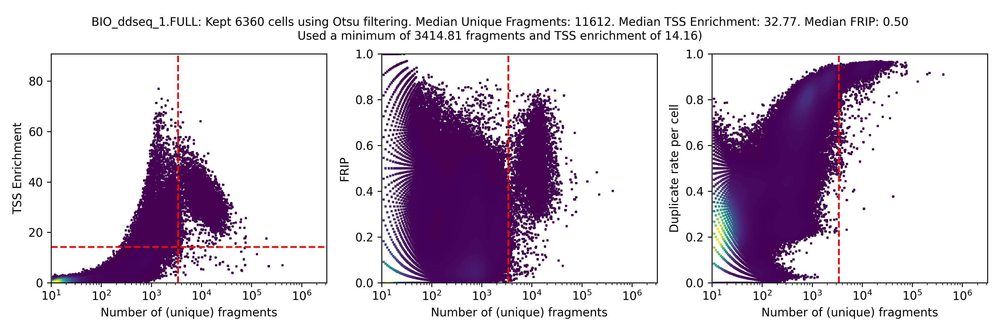

BIO_ddseq_2.FULL bc passing filters exists, printing img and skipping


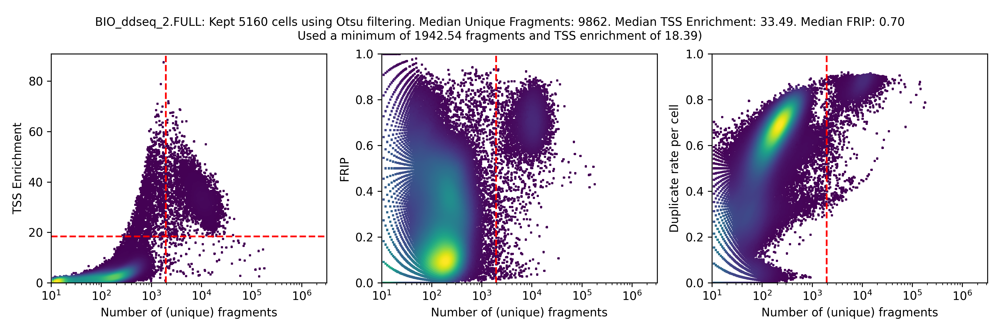

BIO_ddseq_3.FULL bc passing filters exists, printing img and skipping


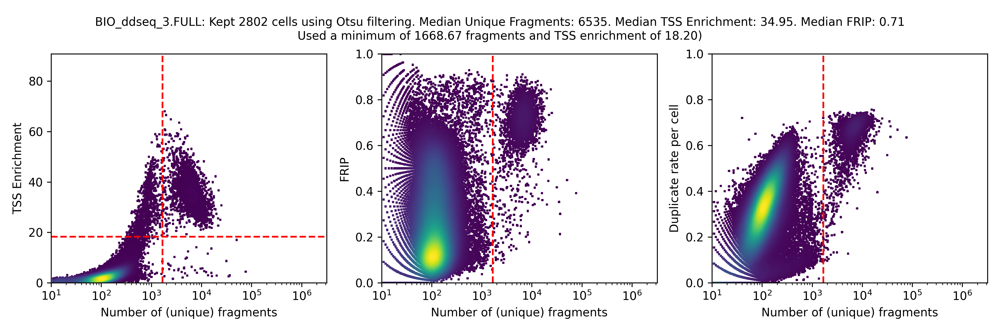

BIO_ddseq_4.FULL bc passing filters exists, printing img and skipping


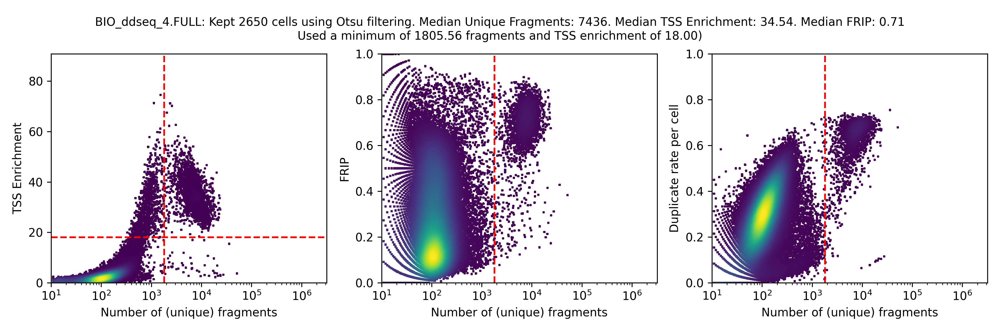

BRO_mtscatac_1.FULL bc passing filters exists, printing img and skipping


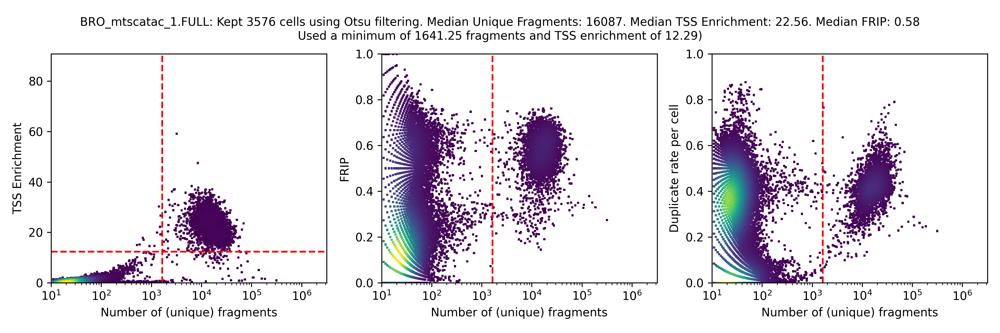

BRO_mtscatac_2.FULL bc passing filters exists, printing img and skipping


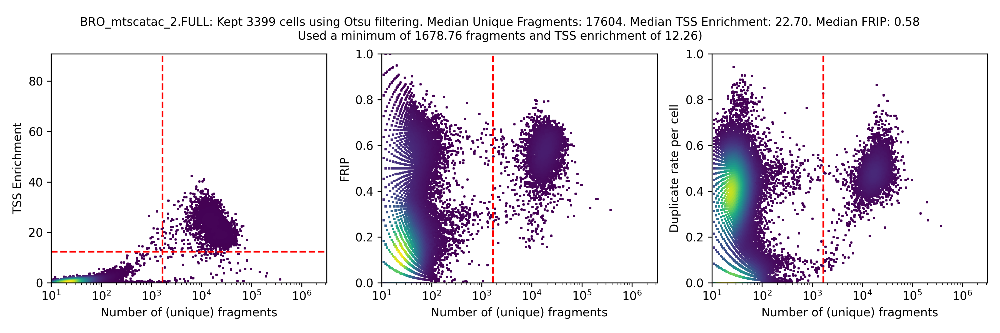

CNA_10xmultiome_1.FULL bc passing filters exists, printing img and skipping


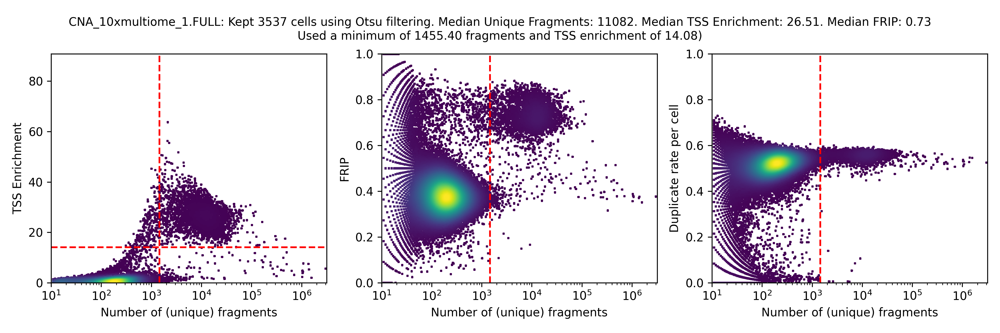

CNA_10xmultiome_2.FULL bc passing filters exists, printing img and skipping


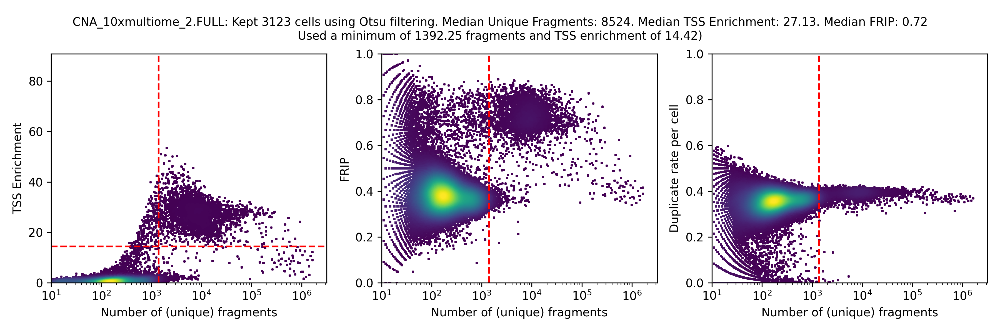

CNA_10xv11_1.FULL bc passing filters exists, printing img and skipping


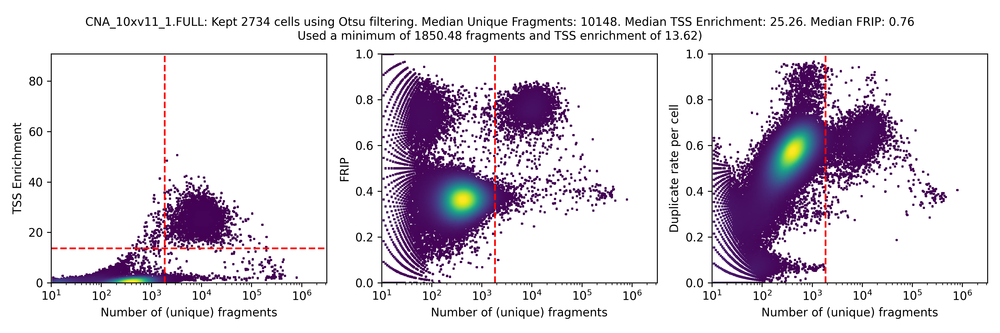

CNA_10xv11_2.FULL bc passing filters exists, printing img and skipping


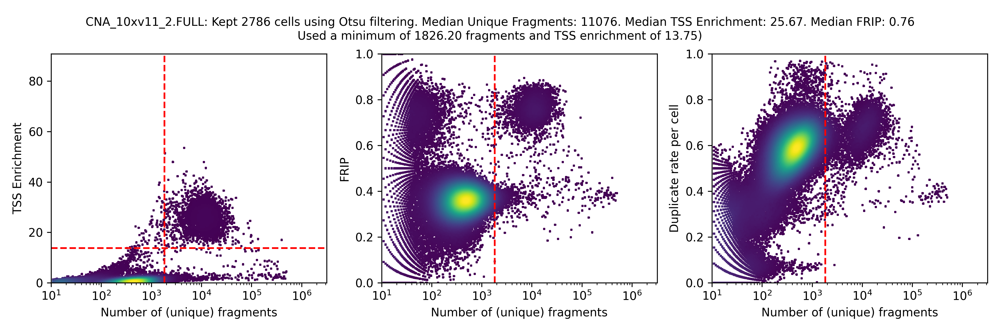

CNA_10xv11_3.FULL bc passing filters exists, printing img and skipping


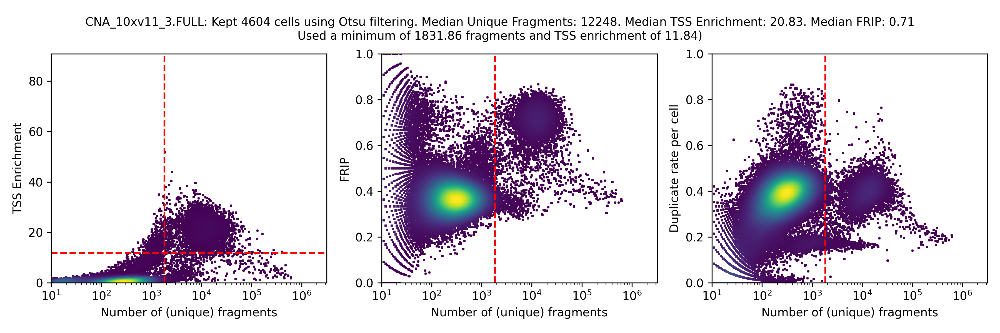

CNA_10xv11_4.FULL bc passing filters exists, printing img and skipping


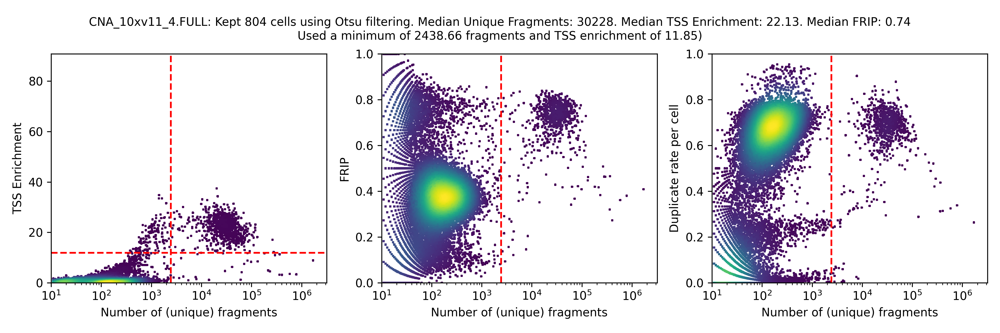

CNA_10xv11_5.FULL bc passing filters exists, printing img and skipping


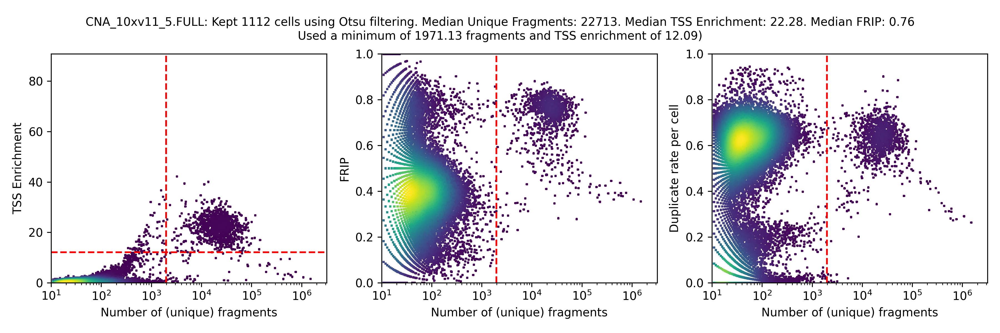

CNA_10xv2_1.FULL bc passing filters exists, printing img and skipping


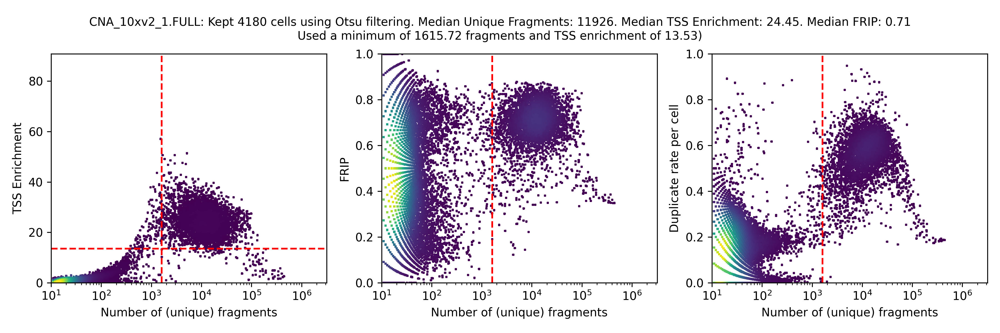

CNA_10xv2_2.FULL bc passing filters exists, printing img and skipping


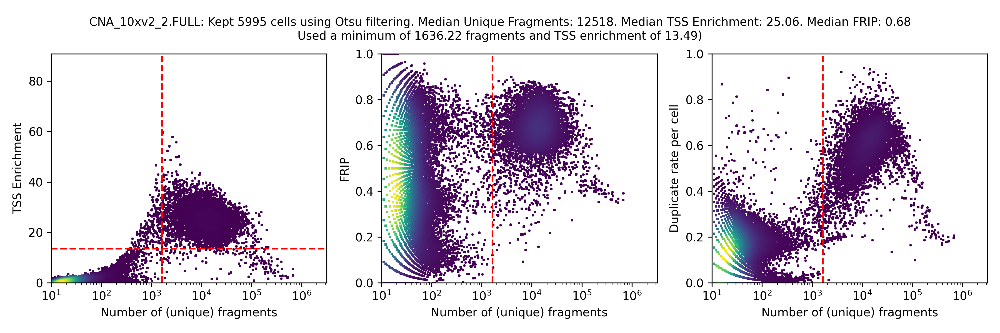

CNA_ddseq_1.FULL bc passing filters exists, printing img and skipping


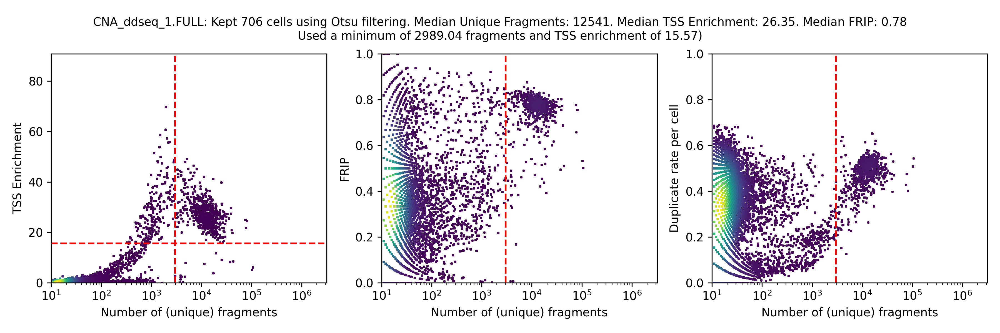

CNA_ddseq_2.FULL bc passing filters exists, printing img and skipping


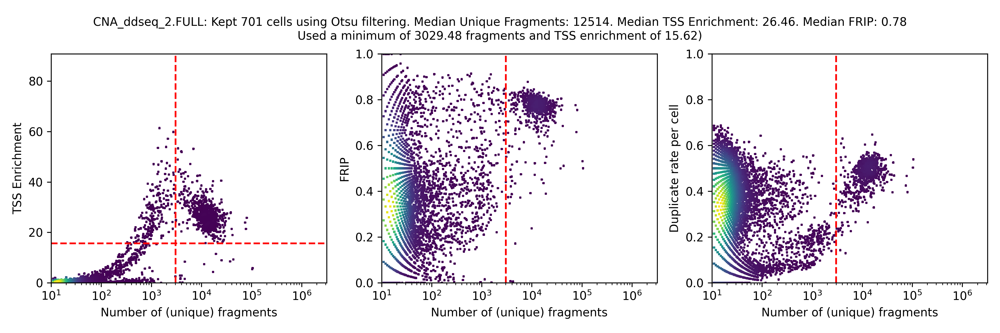

CNA_hydrop_1.FULL bc passing filters exists, printing img and skipping


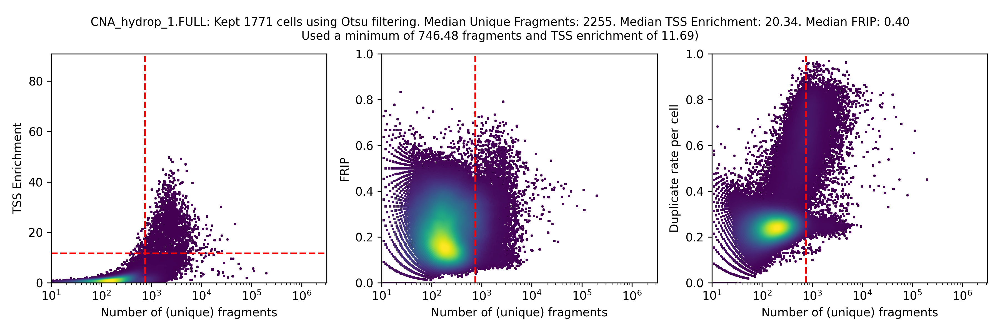

CNA_hydrop_2.FULL bc passing filters exists, printing img and skipping


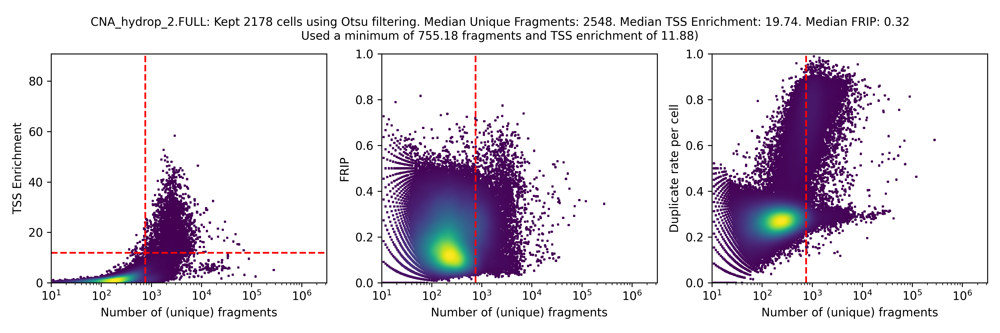

CNA_hydrop_3.FULL bc passing filters exists, printing img and skipping


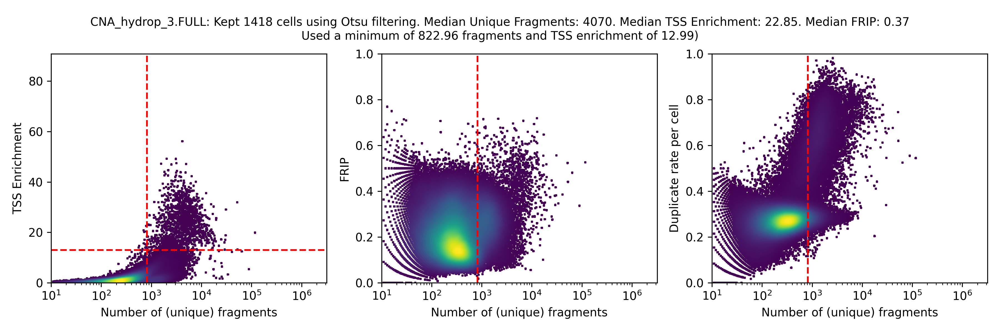

CNA_mtscatac_1.FULL bc passing filters exists, printing img and skipping


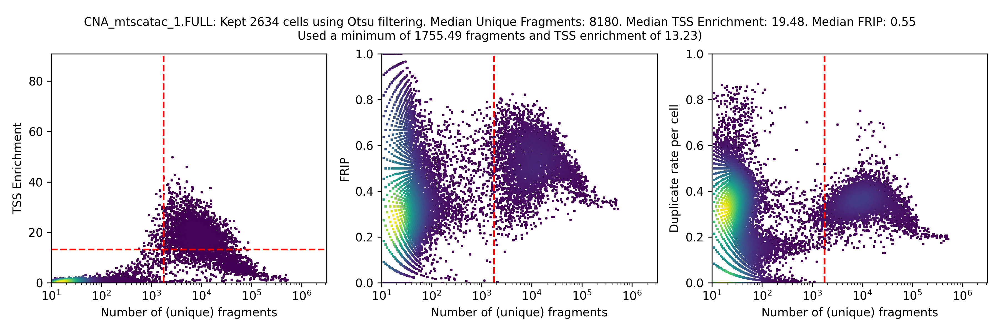

CNA_mtscatac_2.FULL bc passing filters exists, printing img and skipping


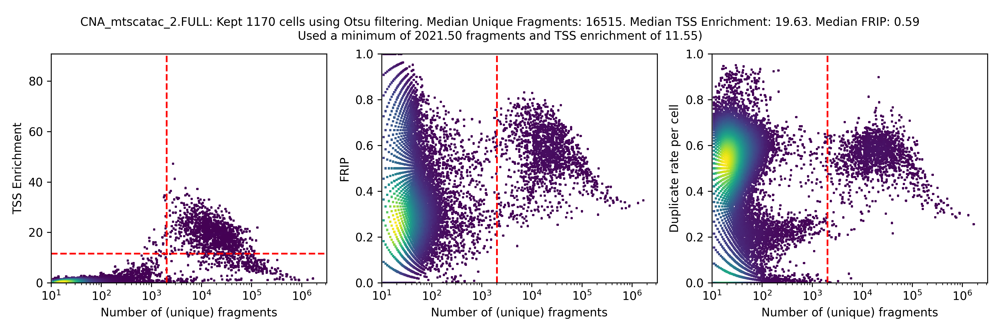

EPF_hydrop_1.FULL bc passing filters exists, printing img and skipping


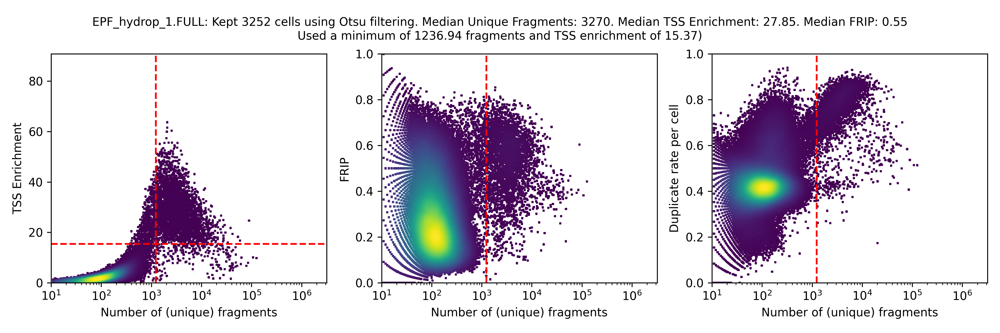

EPF_hydrop_2.FULL bc passing filters exists, printing img and skipping


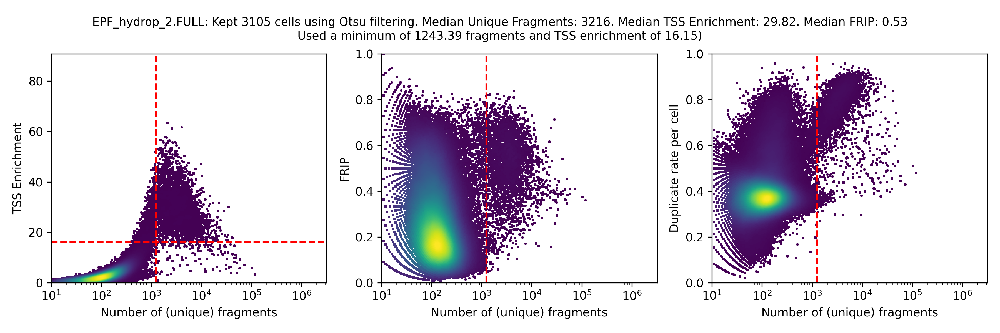

EPF_hydrop_3.FULL bc passing filters exists, printing img and skipping


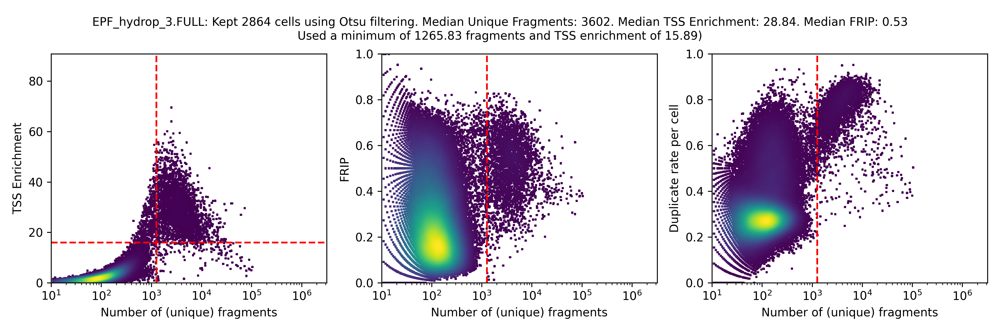

EPF_hydrop_4.FULL bc passing filters exists, printing img and skipping


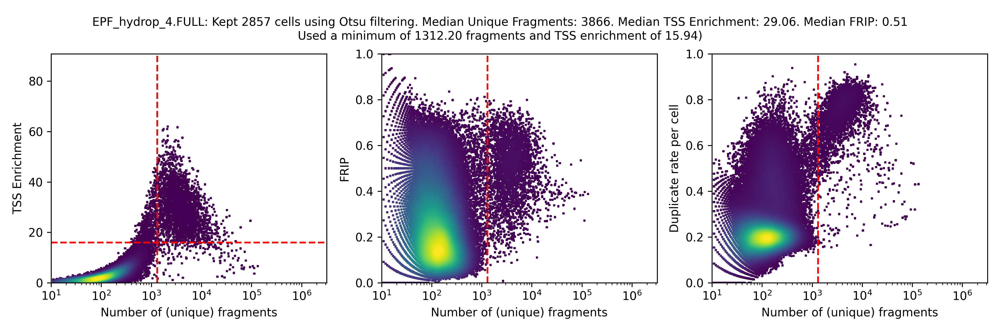

HAR_ddseq_1.FULL bc passing filters exists, printing img and skipping


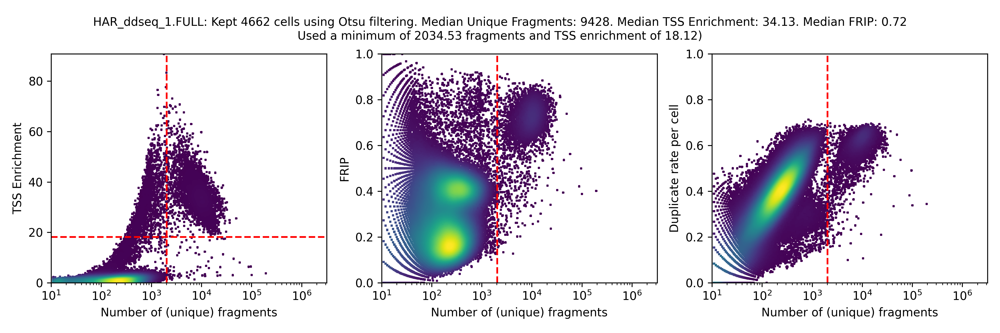

HAR_ddseq_2.FULL bc passing filters exists, printing img and skipping


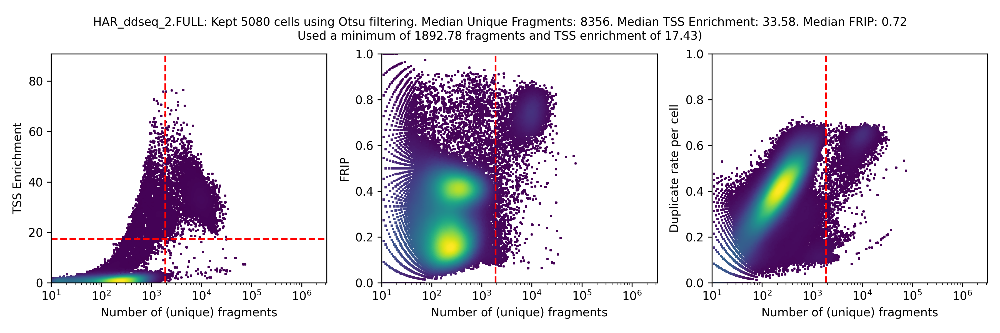

MDC_mtscatac_1.FULL bc passing filters exists, printing img and skipping


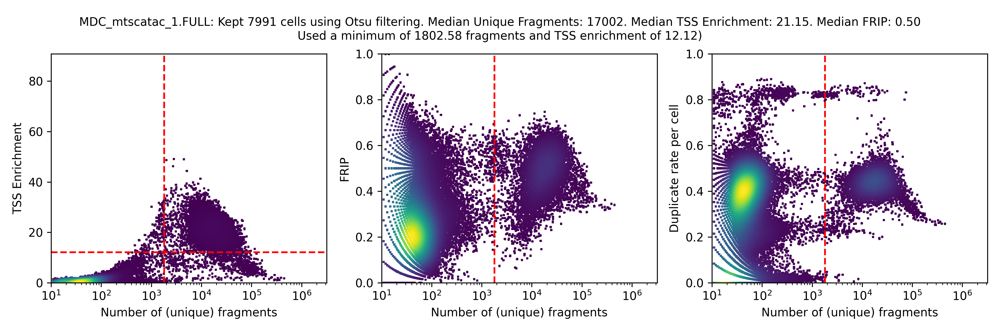

MDC_mtscatac_2.FULL bc passing filters exists, printing img and skipping


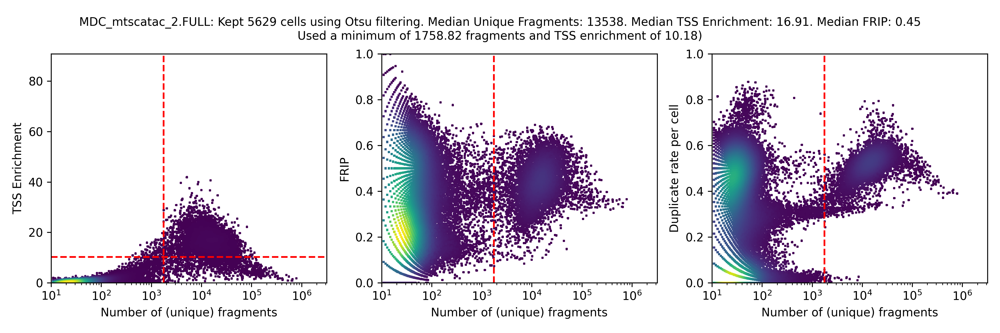

OHS_s3atac_1.FULL bc passing filters exists, printing img and skipping


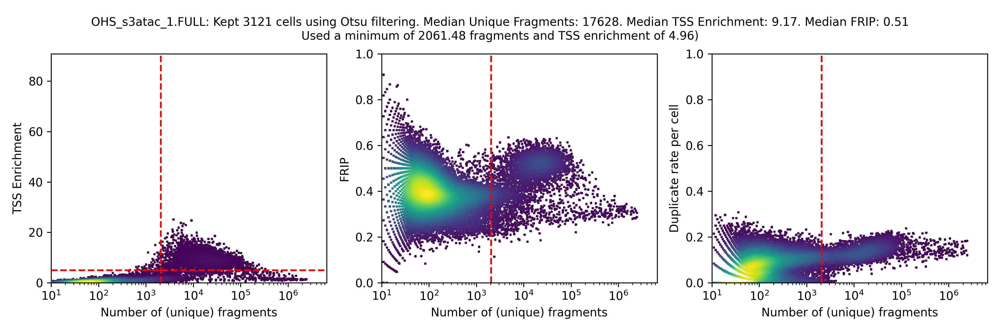

OHS_s3atac_2.FULL bc passing filters exists, printing img and skipping


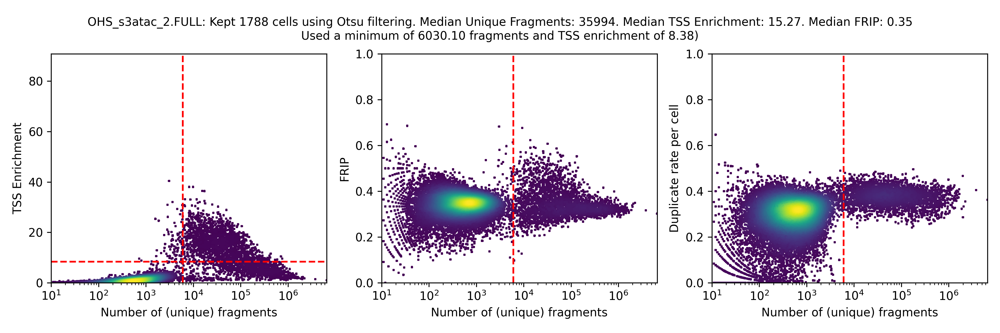

SAN_10xmultiome_1.FULL bc passing filters exists, printing img and skipping


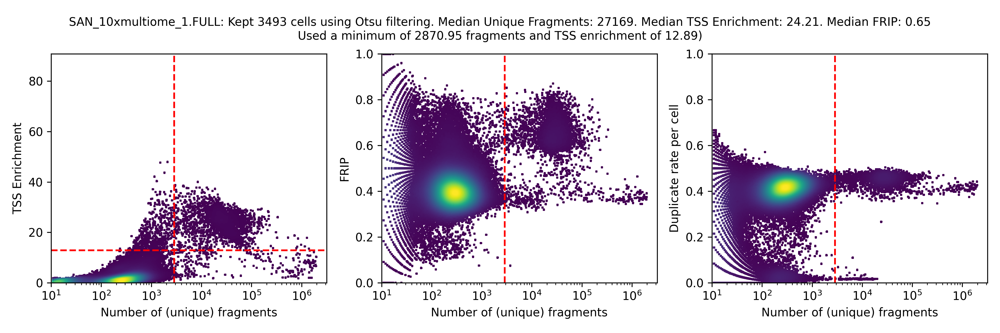

SAN_10xmultiome_2.FULL bc passing filters exists, printing img and skipping


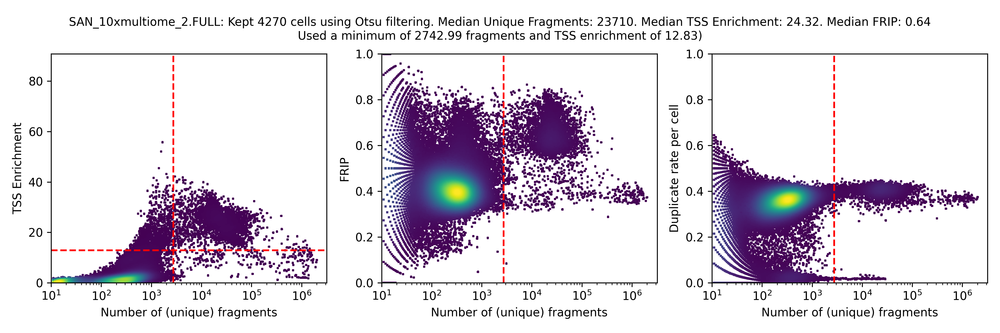

STA_10xv11_1.FULL bc passing filters exists, printing img and skipping


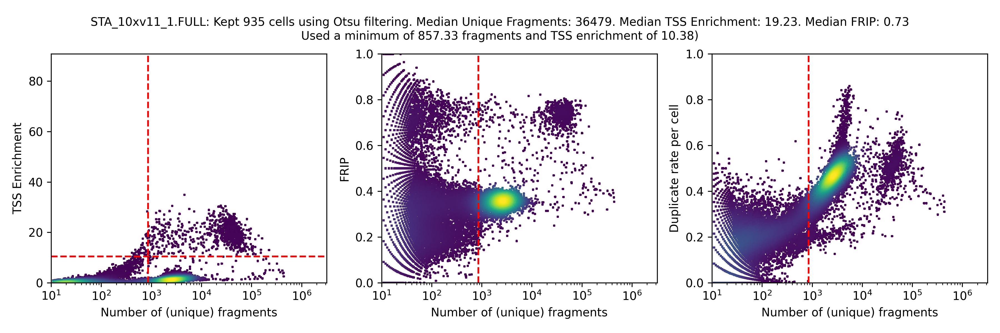

STA_10xv11_2.FULL bc passing filters exists, printing img and skipping


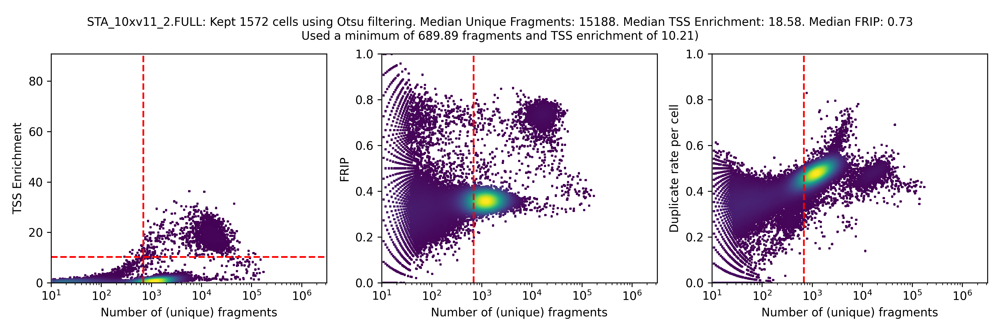

TXG_10xv11_1.FULL bc passing filters exists, printing img and skipping


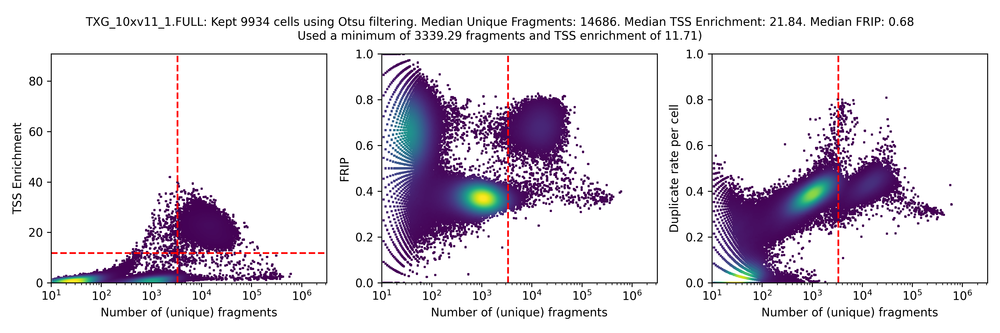

TXG_10xv2_1.FULL bc passing filters exists, printing img and skipping


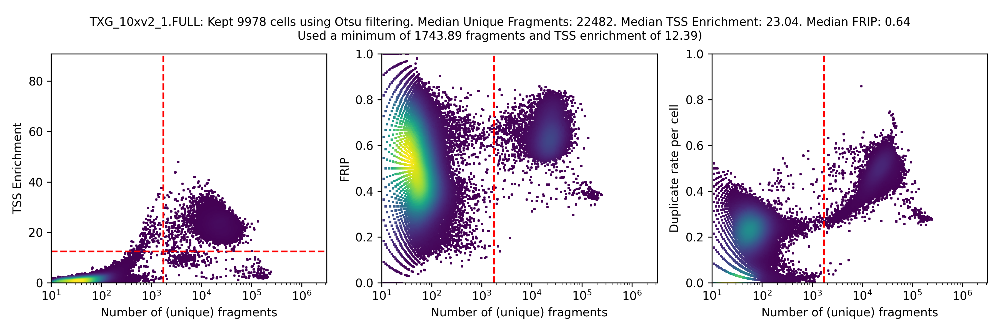

TXG_10xv2_2.FULL bc passing filters exists, printing img and skipping


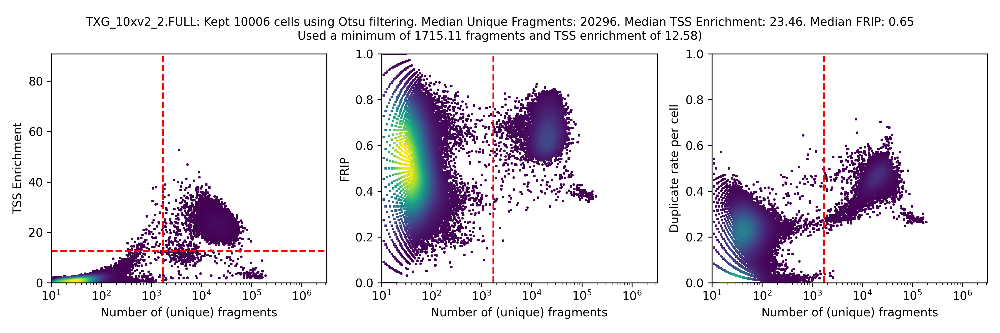

UCS_ddseq_1.FULL bc passing filters exists, printing img and skipping


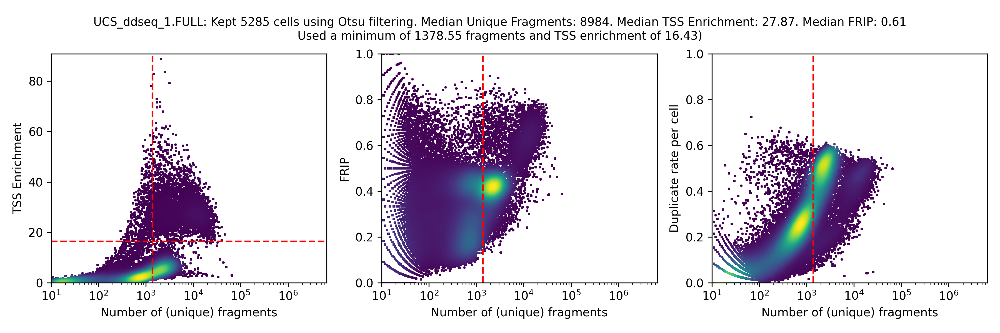

UCS_ddseq_2.FULL bc passing filters exists, printing img and skipping


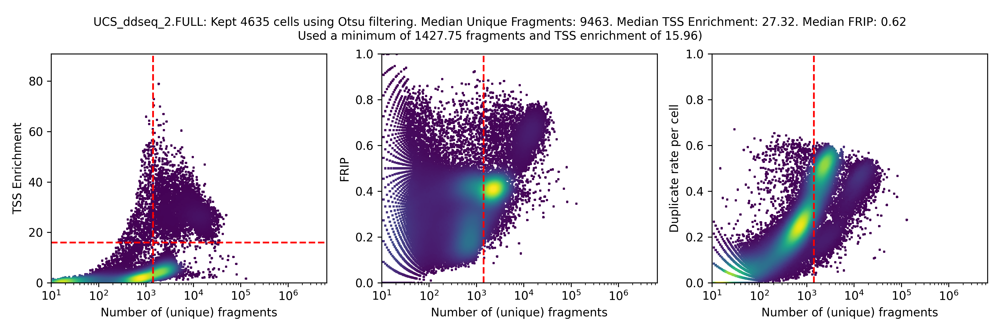

VIB_10xmultiome_1.FULL bc passing filters exists, printing img and skipping


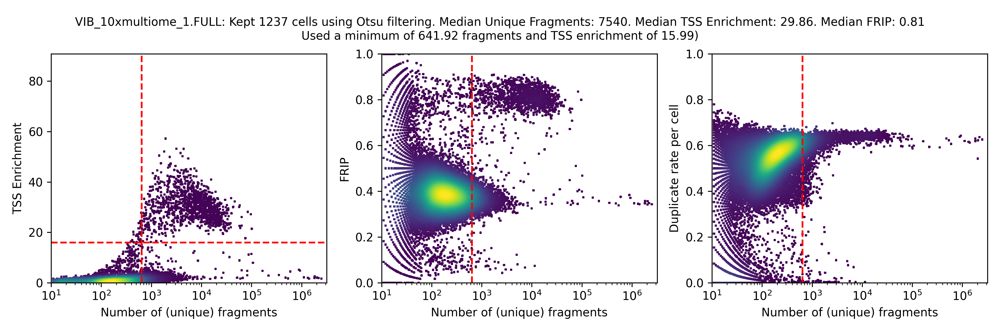

VIB_10xmultiome_2.FULL bc passing filters exists, printing img and skipping


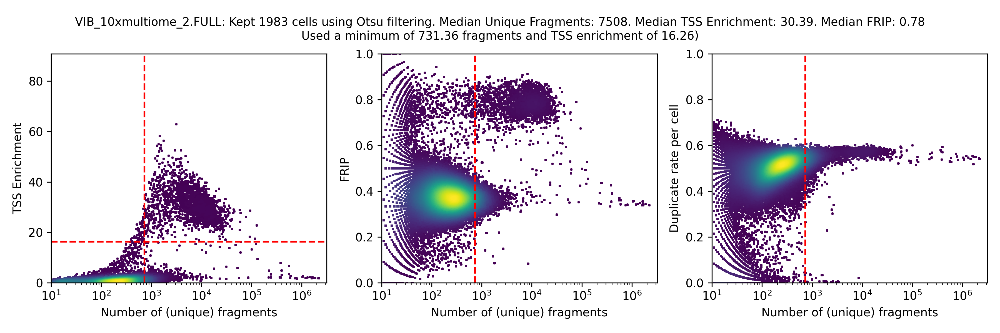

VIB_10xv1_1.FULL bc passing filters exists, printing img and skipping


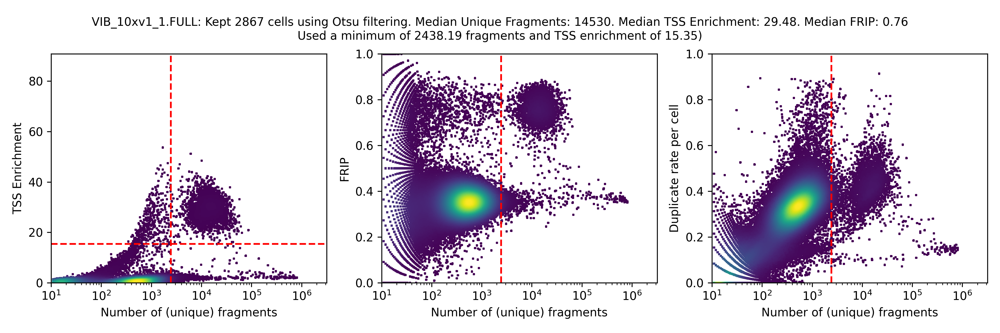

VIB_10xv1_2.FULL bc passing filters exists, printing img and skipping


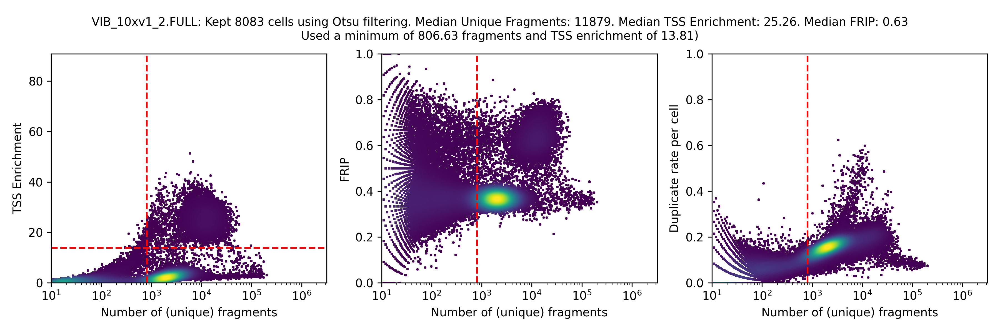

VIB_10xv2_1.FULL bc passing filters exists, printing img and skipping


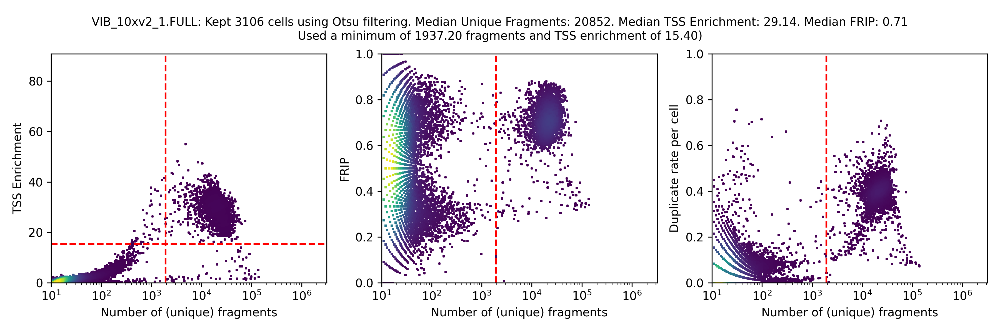

VIB_10xv2_2.FULL bc passing filters exists, printing img and skipping


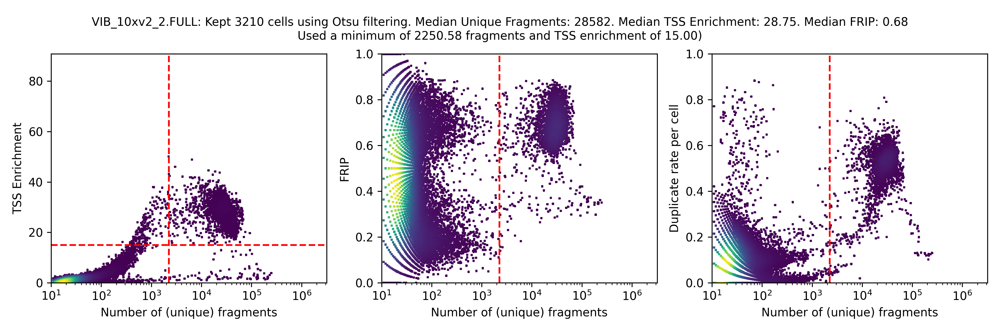

VIB_hydrop_1.FULL bc passing filters exists, printing img and skipping


FileNotFoundError: No such file or directory: 'plots_qc/VIB_hydrop_1.FULL_qc_otsu.png'

FileNotFoundError: No such file or directory: 'plots_qc/VIB_hydrop_1.FULL_qc_otsu.png'

<IPython.core.display.Image object>

VIB_hydrop_11.FULL bc passing filters exists, printing img and skipping


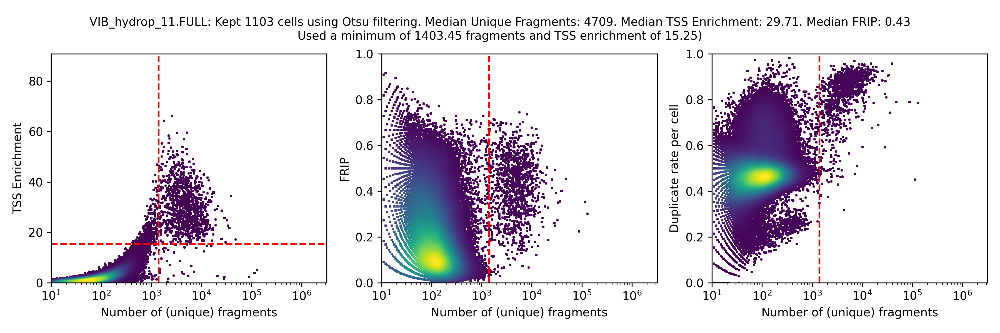

VIB_hydrop_12.FULL bc passing filters exists, printing img and skipping


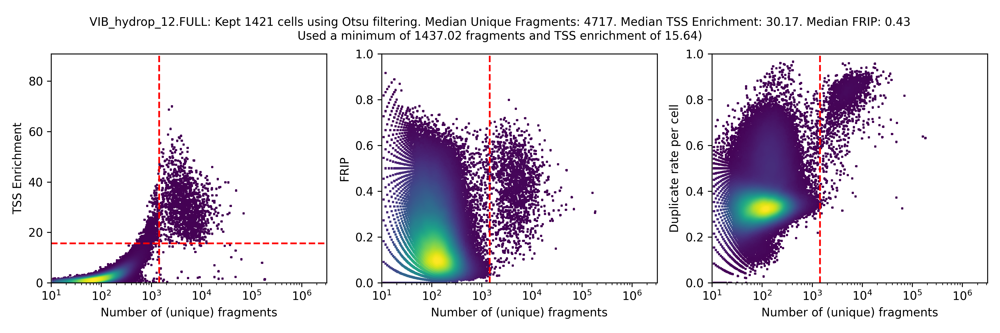

VIB_hydrop_2.FULL bc passing filters exists, printing img and skipping


FileNotFoundError: No such file or directory: 'plots_qc/VIB_hydrop_2.FULL_qc_otsu.png'

FileNotFoundError: No such file or directory: 'plots_qc/VIB_hydrop_2.FULL_qc_otsu.png'

<IPython.core.display.Image object>

VIB_hydrop_21.FULL bc passing filters exists, printing img and skipping


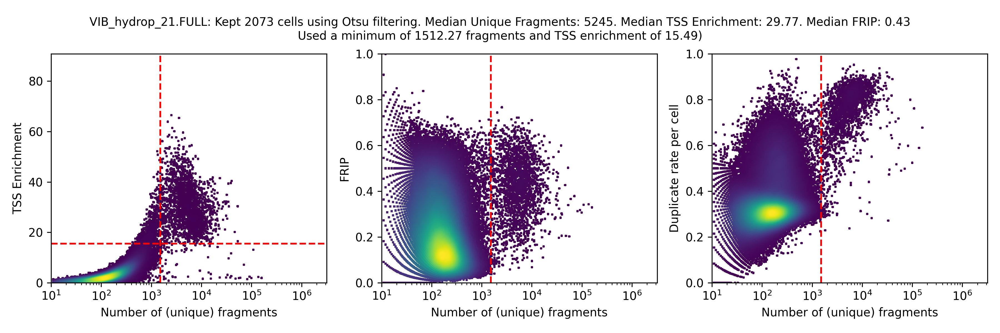

VIB_hydrop_22.FULL bc passing filters exists, printing img and skipping


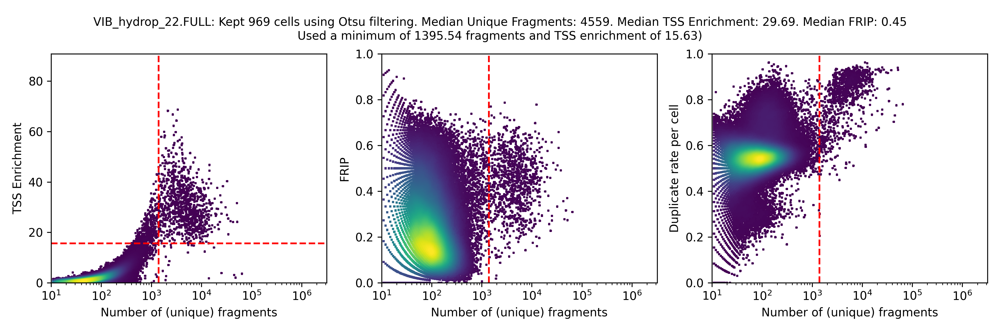

VIB_mtscatac_1.FULL bc passing filters exists, printing img and skipping


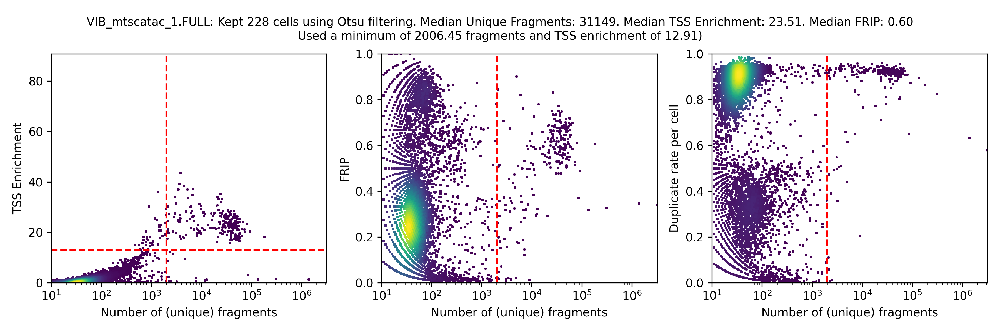

VIB_mtscatac_2.FULL bc passing filters exists, printing img and skipping


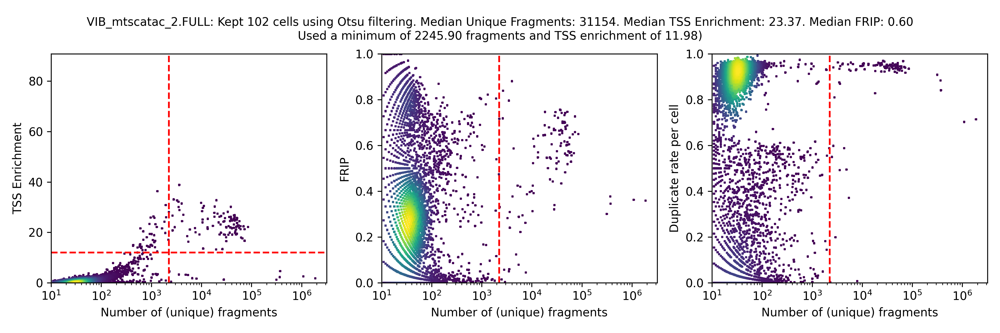

In [29]:
metadata_bc_pkl_list = sorted(glob.glob("cistopic_qc_out/*metadata_bc.pkl"))
metadata_bc_pkl_path_dict = {}
for metadata_bc_pkl_path in metadata_bc_pkl_list:
    sample = metadata_bc_pkl_path.split("/")[-1].split("__metadata_bc.pkl")[0]
    metadata_bc_pkl_path_dict[sample] = metadata_bc_pkl_path

for sample in metadata_bc_pkl_path_dict.keys():
    if os.path.exists(f"selected_barcodes/{sample}_bc_passing_filters_otsu.pkl"):
        print(f"{sample} bc passing filters exists, printing img and skipping")
        display(Image(f"plots_qc/{sample}_qc_otsu.png"))
    else:
        print(
            f"{sample} bc passing filters does not exist yet, generate using qc_plots.py script!"
        )

In [ ]:
import kde
import pycisTopic
import glob
import os
import pandas as pd
import pickle
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import multiprocess as mp
from multiprocess import Pool
import pprint as pp

def histogram(array, nbins=100):
    """
    Draw histogram from distribution and identify centers.
    Parameters
    ---------
    array: `class::np.array`
            Scores distribution
    nbins: int
            Number of bins to use in the histogram
    Return
    ---------
    float
            Histogram values and bin centers.
    """
    array = array.ravel().flatten()
    hist, bin_edges = np.histogram(array, bins=nbins, range=None)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.0
    return hist, bin_centers


def threshold_otsu(array, nbins=100, min_value=100):
    """
    Apply Otsu threshold on topic-region distributions [Otsu, 1979].
    Parameters
    ---------
    array: `class::np.array`
            Array containing the region values for the topic to be binarized.
    nbins: int
            Number of bins to use in the binarization histogram
    Return
    ---------
    float
            Binarization threshold.
    Reference
    ---------
    Otsu, N., 1979. A threshold selection method from gray-level histograms. IEEE transactions on systems, man, and
    cybernetics, 9(1), pp.62-66.
    """
    array = array[(array >= min_value)]
    hist, bin_centers = histogram(array, nbins)
    hist = hist.astype(float)
    # Class probabilities for all possible thresholds
    weight1 = np.cumsum(hist)
    weight2 = np.cumsum(hist[::-1])[::-1]
    # Class means for all possible thresholds
    mean1 = np.cumsum(hist * bin_centers) / weight1
    mean2 = (np.cumsum((hist * bin_centers)[::-1]) / weight2[::-1])[::-1]
    # Clip ends to align class 1 and class 2 variables:
    # The last value of ``weight1``/``mean1`` should pair with zero values in
    # ``weight2``/``mean2``, which do not exist.
    variance12 = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2
    idx = np.argmax(variance12)
    threshold = bin_centers[:-1][idx]
    return threshold


# def calc_kde(xy):
#     return gaussian_kde(xy)(xy)


def plot_frag_qc(
    x,
    y,
    ax,
    x_thr_min=None,
    x_thr_max=None,
    y_thr_min=None,
    y_thr_max=None,
    ylab=None,
    xlab="Number of (unique) fragments",
    cmap="viridis",
    density_overlay=False,
    s=10,
    marker="+",
    c="#343434",
    xlim=None,
    ylim=None,
    **kwargs
):
    from scipy.stats import gaussian_kde

    assert all(x.index == y.index)
    barcodes = x.index.values

    if density_overlay:
        cores = 8

        x_log = np.log(x)

        # Split input array for KDE [log(x), y] array in
        # equaly spaced parts (start_offset + n * nbr_cores).
        kde_parts = [np.vstack([x_log[i::cores], y[i::cores]]) for i in range(cores)]

        # Get nultiprocess context object to spawn processes.
        # mp_ctx = mp.get_context("spawn")

        # Calculate KDE in parallel.
        with Pool(processes=cores) as pool:
            results = pool.map(kde.calc_kde, kde_parts)

        z = np.concatenate(results)

        # now order x and y in the same way that z was ordered, otherwise random z value is assigned to barcode:
        x_ordered = np.concatenate([x[i::cores] for i in range(cores)])
        y_ordered = np.concatenate([y[i::cores] for i in range(cores)])

        idx = (
            z.argsort()
        )  # order based on z value so that highest value is plotted on top, and not hidden by lower values
        x, y, z, barcodes = x_ordered[idx], y_ordered[idx], z[idx], barcodes[idx]
    else:
        z = c
    
    df_dict = {"x": x, "y":y, "z":z}
    df = pd.DataFrame(df_dict)
    
    sp = ax.scatter(x, y, c=z, s=s, edgecolors=None, marker=marker, cmap=cmap, **kwargs)
    if ylim is not None:
        ax.set_ylim(ylim[0], ylim[1])
    if xlim is not None:
        ax.set_xlim(xlim[0], xlim[1])

    # Start with keeping all barcodes.
    barcodes_to_keep = np.full(x.shape[0], True)

    # Filter barcodes out if needed based on thresholds:
    if x_thr_min is not None:
        ax.axvline(x=x_thr_min, color="r", linestyle="--")

    if x_thr_max is not None:
        ax.axvline(x=x_thr_max, color="r", linestyle="--")

    if y_thr_min is not None:
        ax.axhline(y=y_thr_min, color="r", linestyle="--")

    if y_thr_max is not None:
        ax.axhline(y=y_thr_max, color="r", linestyle="--")

    ax.set_xscale("log")
    ax.set_xmargin(0.01)
    ax.set_ymargin(0.01)
    ax.set_xlabel(xlab, fontsize=10)
    ax.set_ylabel(ylab, fontsize=10)

def calc_qc_df(
    sample,
    min_dict,
    max_dict,
    metadata_bc_df,
    include_kde=False,
    detailed_title=True,
    s=4,
    min_x_val=100,
    min_y_val=1
):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4), dpi=150)

    # calculate thresholds using a double otsu strategy:
    # first we calculate an otsu threshold using a minimum of 10 fragments
    # then, this otsu threshold is used as the minimum for the second iteration

    x_arr = np.log10(metadata_bc_df["Unique_nr_frag"])
    x_threshold_log = threshold_otsu(x_arr, nbins=5000, min_value=np.log10(min_x_val))
    x_threshold = 10**x_threshold_log

    y_arr = metadata_bc_df["TSS_enrichment"]
    y_threshold = threshold_otsu(y_arr, nbins=5000, min_value=min_y_val)

    # calculate cells passing filter
    metadata_bc_df_passing_filters = metadata_bc_df.loc[
        (metadata_bc_df.Unique_nr_frag > x_threshold)
        & (metadata_bc_df.TSS_enrichment > y_threshold)
    ]
    bc_passing_filters = metadata_bc_df_passing_filters.index
    
    return bc_passing_filters, fig
)
    
def plot_qc(
    sample,
    min_dict,
    max_dict,
    metadata_bc_df,
    include_kde=False,
    detailed_title=True,
    s=4,
    min_x_val=100,
    min_y_val=1
):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4), dpi=150)

    # calculate thresholds using a double otsu strategy:
    # first we calculate an otsu threshold using a minimum of 10 fragments
    # then, this otsu threshold is used as the minimum for the second iteration

    x_arr = np.log10(metadata_bc_df["Unique_nr_frag"])
    x_threshold_log = threshold_otsu(x_arr, nbins=5000, min_value=np.log10(min_x_val))
    x_threshold = 10**x_threshold_log

    y_arr = metadata_bc_df["TSS_enrichment"]
    y_threshold = threshold_otsu(y_arr, nbins=5000, min_value=min_y_val)

    # calculate cells passing filter
    metadata_bc_df_passing_filters = metadata_bc_df.loc[
        (metadata_bc_df.Unique_nr_frag > x_threshold)
        & (metadata_bc_df.TSS_enrichment > y_threshold)
    ]
    bc_passing_filters = metadata_bc_df_passing_filters.index

    # plot everything
    plot_frag_qc(
        x=metadata_bc_df["Unique_nr_frag"],
        y=metadata_bc_df["TSS_enrichment"],
        ylab="TSS Enrichment",
        s=s,
        x_thr_min=x_threshold,
        y_thr_min=y_threshold,
        xlim=[10, max_dict["Unique_nr_frag"]],
        ylim=[0, max_dict["TSS_enrichment"]],
        density_overlay=include_kde,
        ax=ax1,
    )
    plot_frag_qc(
        x=metadata_bc_df["Unique_nr_frag"],
        y=metadata_bc_df["FRIP"],
        x_thr_min=x_threshold,
        ylab="FRIP",
        s=s,
        xlim=[10, max_dict["Unique_nr_frag"]],
        ylim=[0, 1],
        density_overlay=include_kde,
        ax=ax2,
    )
    plot_frag_qc(
        x=metadata_bc_df["Unique_nr_frag"],
        y=metadata_bc_df["Dupl_rate"],
        x_thr_min=x_threshold,
        ylab="Duplicate rate per cell",
        s=s,
        xlim=[10, max_dict["Unique_nr_frag"]],
        ylim=[0, 1],
        density_overlay=include_kde,
        ax=ax3,
    )

    if detailed_title:
        med_nf = round(
            metadata_bc_df.loc[bc_passing_filters, "Unique_nr_frag"].median(), 2
        )
        med_tss = round(
            metadata_bc_df.loc[bc_passing_filters, "TSS_enrichment"].median(), 2
        )
        med_frip = round(metadata_bc_df.loc[bc_passing_filters, "FRIP"].median(), 2)
        title = f"{sample}: Kept {len(bc_passing_filters)} cells using Otsu filtering. Median Unique Fragments: {med_nf:.0f}. Median TSS Enrichment: {med_tss:.2f}. Median FRIP: {med_frip:.2f}\nUsed a minimum of {x_threshold:.2f} fragments and TSS enrichment of {y_threshold:.2f})"
    else:
        title = sample

    fig.suptitle(title, x=0.5, y=0.95, fontsize=10)
    return bc_passing_filters, fig


###################
# Run the loop here
###################

metadata_bc_pkl_list = sorted(glob.glob("cistopic_qc_out/*metadata_bc.pkl"))
metadata_bc_pkl_path_dict = {}
for metadata_bc_pkl_path in metadata_bc_pkl_list:
    sample = metadata_bc_pkl_path.split("/")[-1].split("__metadata_bc.pkl")[0]
    metadata_bc_pkl_path_dict[sample] = metadata_bc_pkl_path

# calculate global maxima to make nice equal plots:
metadata_bc_df_all = pd.DataFrame()
for sample in metadata_bc_pkl_path_dict.keys():
    with open(metadata_bc_pkl_path_dict[sample], "rb") as fh:
        metadata_bc_df = pickle.load(fh)
        metadata_bc_df_all = pd.concat([metadata_bc_df_all, metadata_bc_df])
        print(f"added {sample} metadata_bc_df")

max_dict = {}
min_dict = {}
for stat in metadata_bc_df_all.columns:
    max_dict[stat] = metadata_bc_df_all[stat].max()
    min_dict[stat] = metadata_bc_df_all[stat].min()

pp.pprint(min_dict)
pp.pprint(max_dict)

standard_min_x_val = 100
standard_min_y_val = 0.5
min_otsu_frags_dict = {}
min_otsu_tss_dict = {}
for metadata_bc_pkl_path in sorted(metadata_bc_pkl_path_dict.keys()):
    sample = metadata_bc_pkl_path.split("/")[-1].split("__metadata_bc.pkl")[0]
    tech = sample.split('_')[1]
    if tech == "ddseq":
        min_otsu_frags_dict[sample] = 200
    elif tech == "hydrop":
        min_otsu_frags_dict[sample] = 300
    else:
        min_otsu_frags_dict[sample] = standard_min_x_val

    if tech == "s3atac":
        min_otsu_tss_dict[sample] = 0
    else:
        min_otsu_tss_dict[sample] = standard_min_y_val

pp.pprint(min_otsu_frags_dict)

for sample in metadata_bc_pkl_path_dict.keys():
    pkl_path = f"selected_barcodes/{sample}_bc_passing_filters_otsu.pkl"
    if os.path.exists(pkl_path):
        print(f"{pkl_path} bc passing filters exists, skipping...")
    else:
        print(f"{pkl_path} bc passing filters does not exist yet, generating...")
        print(f"\tLoading {metadata_bc_pkl_path_dict[sample]}")
        with open(metadata_bc_pkl_path_dict[sample], "rb") as fh:
            metadata_bc_df = pickle.load(fh)

        print(f"\tFiltering cells and generating QC plots.")
        if not sample in min_otsu_frags_dict.keys():
            print(f"\t{sample} not in minimum dict! Using standard value of {standard_min_x_val}")
            min_x_val = standard_min_x_val
            min_y_val = standard_min_y_val
        else:
            min_x_val = min_otsu_frags_dict[sample]
            min_y_val = min_otsu_tss_dict[sample]

        bc_passing_filters, fig = plot_qc(sample=sample, min_dict=min_dict, max_dict=max_dict, metadata_bc_df=metadata_bc_df, include_kde=kde, min_x_val=min_x_val, min_y_val=min_y_val)

# Write raw barcode file

Freemuxlet reads barcodes in the bam file. These barcodes (tag: DB) do not contain the `sample` suffix, which is included in the `*_bc_passing_filters_otsu.txt` files:

In [15]:
!head selected_barcodes/BIO_ddseq_1.FULL_bc_passing_filters_otsu.txt

AAGGTTCTTTCCTAAGAGACC_CCGCGATCACGCCAATTATTC_CTGCGCCTGTTTAGATTGCCT___BIO_ddseq_1.FULL
GAGAGGTGACAATATGGTGAA___BIO_ddseq_1.FULL
CGATTACGCTCCAAGAGCTAA_CTAGAGCACACGCGTACTTTC_GGCGTCCTAACGCCCGTAGCC___BIO_ddseq_1.FULL
CTAGAGCGGTTAGTGTGGCGC_GCTTTATTTGGACTCGAGGTC_GTTGATGTCATACAGTGGTAG___BIO_ddseq_1.FULL
CGCGCTTTCTTGTAAGCCGCC_CTTGTCCCGTGATATGATTGT___BIO_ddseq_1.FULL
AGCCGCCGCACAGCCCATAAT_CGAGTGGTGGTGAATAGTGTT_GAATCAACGAGTGGCAGGCGG___BIO_ddseq_1.FULL
CACATGATGCGAGCCTCATTT_CAGAGAGTGGTGAAACCTACC_GAATATGTGACCGCTGGTGAA_TCAAGACCGGATCTATTGCCT___BIO_ddseq_1.FULL
CGAGTGGGAGGACAAGATAGG_CGTGATAATGAATATGCGAGC_TCAAGACGTGTGTCAACTCTT___BIO_ddseq_1.FULL
CTCTTGCTGCGTTGCGGCTGC_TCGACAGCGGTACGAACGTAA___BIO_ddseq_1.FULL
CCACTTGCACATGACTAACTC_TATGTGCACGAGAACCAAGCT___BIO_ddseq_1.FULL


In [1]:
for file in sorted(glob.glob("selected_barcodes/*FULL_bc_passing_filters_otsu.txt")):
    print(file)
    sample = file.split("/")[-1].split("_bc_passing_filters_otsu.txt")[0]
    print(sample)
    df = pd.read_csv(file, header=None, index_col=None)

    with open(f"selected_barcodes/{sample}_bc_passing_filters_otsu.RAW.txt", "w") as fp:
        for x in df[0]:
            # write each item on a new line
            fp.write(x.split("___")[0] + "\n")
        print("Done")

NameError: name 'glob' is not defined